In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing
import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator
import seaborn as sns
import plotly.express as px

%matplotlib inline

In [ ]:
# Set DPI for fugures

plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

In [ ]:
plt.rcParams['font.size'] = 20

In [ ]:
# Drive connection

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Importing Dataset
train = pd.read_csv('/content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/Data/train_df.csv')
test = pd.read_csv('/content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/Data/test_df.csv')

In [ ]:
# Rename the column 'Dominance' to 'Dominancencoded_e'
train.rename(columns={'Domain': 'Dominance'}, inplace=True)
test.rename(columns={'Domain': 'Dominance'}, inplace=True)

In [ ]:
# Rename the column 'Liking' to 'Liking'
train.rename(columns={'Like': 'Liking'}, inplace=True)
test.rename(columns={'Like': 'Liking'}, inplace=True)

In [ ]:
# Copy the original dataset
encoded_train = train.copy()

# List of columns to modify
# columns_to_modify = ['Valence', 'Arousal', 'Dominance', 'Liking']
columns_to_modify = ['Valence']

# Apply the transformation: 1-4.99 becomes 0, everything else becomes 1
encoded_train[columns_to_modify] = encoded_train[columns_to_modify].applymap(
    lambda x: 0 if 1 <= x <= 4.99 else 1
)

<ipython-input-8-71f80eed8014>:9: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  encoded_train[columns_to_modify] = encoded_train[columns_to_modify].applymap(


In [ ]:
# Replace 9 with 8.99 in specified columns
columns_to_update = ['Arousal', 'Dominance', 'Liking']
encoded_train[columns_to_update] = encoded_train[columns_to_update].replace(9, 8.99)

In [ ]:
# Copy
encoded_test = test.copy()

# List of columns to modify
#columns_to_modify = ['Valence', 'Arousal', 'Dominance', 'Liking']
columns_to_modify = ['Valence']

# Apply the transformation: 1-4.99 becomes 0, 5-9 becomes 1
encoded_test[columns_to_modify] = encoded_test[columns_to_modify].applymap(
    lambda x: 0 if 1 <= x <= 4.99 else 1
)

<ipython-input-10-874960b9dd8c>:9: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  encoded_test[columns_to_modify] = encoded_test[columns_to_modify].applymap(


In [ ]:
# Replace 9 with 8.99 in specified columns
columns_to_update = ['Arousal', 'Dominance', 'Liking']
encoded_test[columns_to_update] = encoded_test[columns_to_update].replace(9, 8.99)

## Train-Test Split

In [ ]:
# Labeling
X_train = encoded_train.drop(['Valence', 'Arousal', 'Dominance', 'Liking'], axis=1) # Input features
Y_train = encoded_train['Valence'] # Target label

x_test = encoded_test.drop(['Valence', 'Arousal', 'Dominance', 'Liking'], axis=1) # Input features
y_test = encoded_test['Valence'] # Target label

## Deep Learning Algorithms

In [ ]:
# Fit the train and test data with StandarScaler

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
x_test = scaler.fit_transform(x_test)

In [ ]:
from tensorflow.keras.utils import to_categorical

# Reshape the input data
X_train = np.expand_dims(X_train, axis=-1)
x_test = np.expand_dims(x_test, axis=-1)

# One-hot encode the labels
Y_train = to_categorical(Y_train, num_classes=2)
y_test = to_categorical(y_test, num_classes=2)

### Without feature extension

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 200, 1)         │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1d_8 (Conv1D)         │ (None, 200, 16)        │            112 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_8     │ (None, 200, 16)        │             64 │ conv1d_8[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling1d_8           │ (None, 100, 16)        │              0 │ batch_normalization_8… │
│ (MaxPooling1D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1d_9 (Conv1D)         │ (None, 100, 16)        │          1,552 │ max_pooling1d_8[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_9     │ (None, 100, 16)        │             64 │ conv1d_9[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling1d_9           │ (None, 50, 16)         │              0 │ batch_normalization_9… │
│ (MaxPooling1D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1d_10 (Conv1D)        │ (None, 50, 32)         │          3,104 │ max_pooling1d_9[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_10    │ (None, 50, 32)         │            128 │ conv1d_10[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling1d_10          │ (None, 25, 32)         │              0 │ batch_normalization_1… │
│ (MaxPooling1D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1d_11 (Conv1D)        │ (None, 25, 32)         │          6,176 │ max_pooling1d_10[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_11    │ (None, 25, 32)         │            128 │ conv1d_11[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling1d_11          │ (None, 12, 32)         │              0 │ batch_normalization_1… │
│ (MaxPooling1D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_8 (Flatten)       │ (None, 1600)           │              0 │ max_pooling1d_8[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_9 (Flatten)       │ (None, 800)            │              0 │ max_pooling1d_9[0][0]  │
├──────────────────────

 Total params: 243,410 (950.82 KB)

 Trainable params: 243,218 (950.07 KB)

 Non-trainable params: 192 (768.00 B)

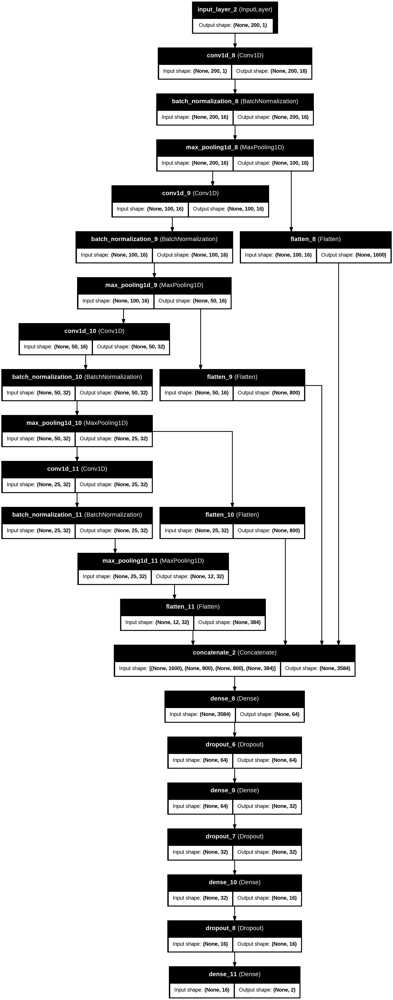

In [ ]:
from keras.layers import Input, Conv1D, BatchNormalization, MaxPooling1D, Flatten, Dense, Dropout, concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.utils import plot_model

# Assuming x_train is your input data with shape (num_samples, num_timesteps, num_features)
input_shape=(X_train.shape[1], 1) #x_train.shape[1]

input_layer = Input(input_shape)

# Convolutional Blocks
conv1 = Conv1D(16, kernel_size=6, padding='same', activation='relu')(input_layer)
bn1 = BatchNormalization()(conv1)
pool1 = MaxPooling1D(pool_size=2)(bn1)

conv2 = Conv1D(16, kernel_size=6, padding='same', activation='relu')(pool1)
bn2 = BatchNormalization()(conv2)
pool2 = MaxPooling1D(pool_size=2)(bn2)

conv3 = Conv1D(32, kernel_size=6, padding='same', activation='relu')(pool2)
bn3 = BatchNormalization()(conv3)
pool3 = MaxPooling1D(pool_size=2)(bn3)

conv4 = Conv1D(32, kernel_size=6, padding='same', activation='relu')(pool3)
bn4 = BatchNormalization()(conv4)
pool4 = MaxPooling1D(pool_size=2)(bn4)

# Flatten layer for each block
flat1 = Flatten()(pool1)
flat2 = Flatten()(pool2)
flat3 = Flatten()(pool3)
flat4 = Flatten()(pool4)

# Concatenate the flattened features
merged = concatenate([flat1, flat2, flat3, flat4])

# Dense Layers
dense1 = Dense(64, activation='relu')(merged)
drop1 = Dropout(0.2)(dense1)

dense2 = Dense(32, activation='relu')(drop1)
drop2 = Dropout(0.2)(dense2)

dense3 = Dense(16, activation='relu')(drop2)
drop3 = Dropout(0.2)(dense3)

# Output layer
output_layer = Dense(2, activation='softmax')(drop3)  # Assuming 2 output classes

# Build the model
model = Model(input_layer, output_layer)
model.summary()

# Plot the model architecture
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

**Compiling the model**

In [ ]:
from tensorflow import keras

# Compile the model
model.compile(loss=keras.losses.categorical_crossentropy,
              optimizer='adam',
              metrics=['accuracy'])

**Automatic save
(We have saved all the details of every epoch in google drive so that we can use this when we need.)**


In [ ]:
# check points and early stopping
from keras.callbacks import ModelCheckpoint,EarlyStopping

model_name = "CNN"
filepath = "/content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/History/" + model_name + "weights-improvement-{epoch:02d}-{accuracy:.4f}.keras"
print(filepath)
checkpoint = ModelCheckpoint(filepath, monitor='accuracy', verbose=1, save_best_only=True, mode='max')
es = EarlyStopping(monitor='accuracy', mode='max', verbose=1, patience=10)
callbacks_list = [es, checkpoint]

/content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/History/CNNweights-improvement-{epoch:02d}-{accuracy:.4f}.keras


In [ ]:
"""
# Train the model
H = model.fit(X_train, Y_train,
          batch_size=100,
          epochs=100,
          verbose=1,
          validation_data=(x_test, y_test),
          callbacks= callbacks_list)
"""

Epoch 1/100
4685/4685 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6207 - loss: 0.6453
Epoch 1: accuracy improved from -inf to 0.64972, saving model to /content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/History/CNNweights-improvement-01-0.6497.keras
4685/4685 ━━━━━━━━━━━━━━━━━━━━ 37s 6ms/step - accuracy: 0.6207 - loss: 0.6453 - val_accuracy: 0.6963 - val_loss: 0.5549
Epoch 2/100
4683/4685 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6886 - loss: 0.5616
Epoch 2: accuracy improved from 0.64972 to 0.69744, saving model to /content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/History/CNNweights-improvement-02-0.6974.keras
4685/4685 ━━━━━━━━━━━━━━━━━━━━ 19s 4ms/step - accuracy: 0.6886 - loss: 0.5616 - val_accuracy: 0.7344 - val_loss: 0.5109
Epoch 3/100
4683/4685 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7213 - loss: 0.5220
Epoch 3: accuracy improved from 0.69744 to 0.72534, saving model t

In [ ]:
"""
from keras.models import save_model

model.save("/content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/model.h5")
"""

In [ ]:
from keras.models import load_model

model_loaded = load_model("/content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/model.h5")

In [ ]:
# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(x_test, y_test, verbose=1)

# Print the test accuracy
print(f'Test Accuracy: {test_accuracy * 100:.2f}%')

4880/4880 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9057 - loss: 0.2309
Test Accuracy: 90.44%


In [ ]:
score = model.evaluate(x_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

4880/4880 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step - accuracy: 0.9057 - loss: 0.2309
Test loss: 0.23223501443862915
Test accuracy: 0.9043801426887512


In [ ]:
"""
import pickle

# Specify the correct file path
history_file_path = '/content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/History/history.pkl'

# Save the model history to the file
with open(history_file_path, 'wb') as file_pi:
    pickle.dump(H, file_pi)
"""

In [ ]:
import pickle

# Correct path with file name and extension
history_filepath = '/content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/History/history.pkl'

# Load the history from the file
with open(history_filepath, 'rb') as file:
    load_history = pickle.load(file)

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 26 variables whereas the saved optimizer has 50 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


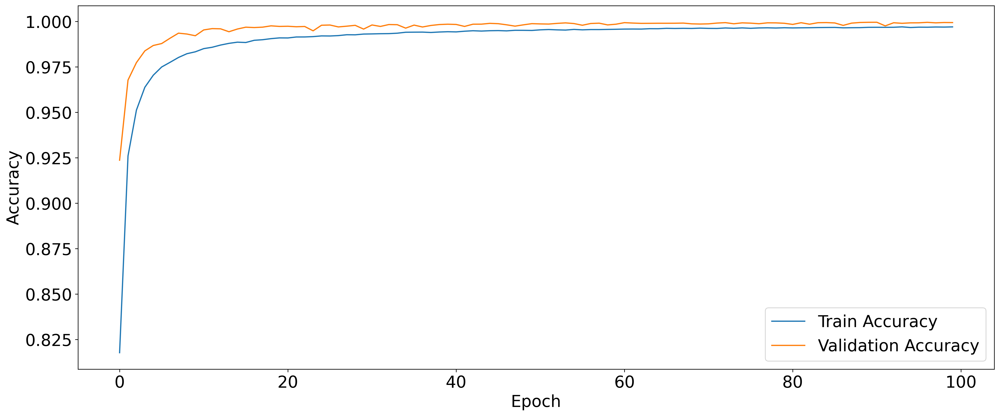

In [ ]:
import matplotlib.pyplot as plt

plt.rcParams["figure.figsize"] = (20, 8)
plt.rcParams["font.size"] = 20

# Access accuracy and validation accuracy using the 'history' attribute
plt.plot(load_history.history['accuracy'], label='Train Accuracy')
plt.plot(load_history.history['val_accuracy'], label='Validation Accuracy')

#plt.title('CNN Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.show()

In [ ]:
"""
from keras.models import save_model

model.save("/content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/model.h5")
"""

In [ ]:
from keras.models import load_model

model_loaded = load_model("/content/drive/Shareddrives/Best Shared Drive Ever/Simon-personal/EEG-Brain/Model/Feature-Extension/model.h5")

In [ ]:
from keras.models import load_model

score = model_loaded.evaluate(x_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

4880/4880 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9057 - loss: 0.2309
Test loss: 0.23223501443862915
Test accuracy: 0.9043801426887512


In [ ]:
y_true = np.array(y_test)
y_pred = model_loaded.predict(x_test)

4880/4880 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step


**Classification report of CNN model**

In [ ]:
y_pred = np.squeeze(y_pred)
y_pred = np.array(y_pred >= 0.5, dtype=int)  # Use 'int' instead of 'np.int'

from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.91      0.89     67832
           1       0.93      0.90      0.91     88328

   micro avg       0.90      0.90      0.90    156160
   macro avg       0.90      0.90      0.90    156160
weighted avg       0.91      0.90      0.90    156160
 samples avg       0.90      0.90      0.90    156160



4880/4880 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step


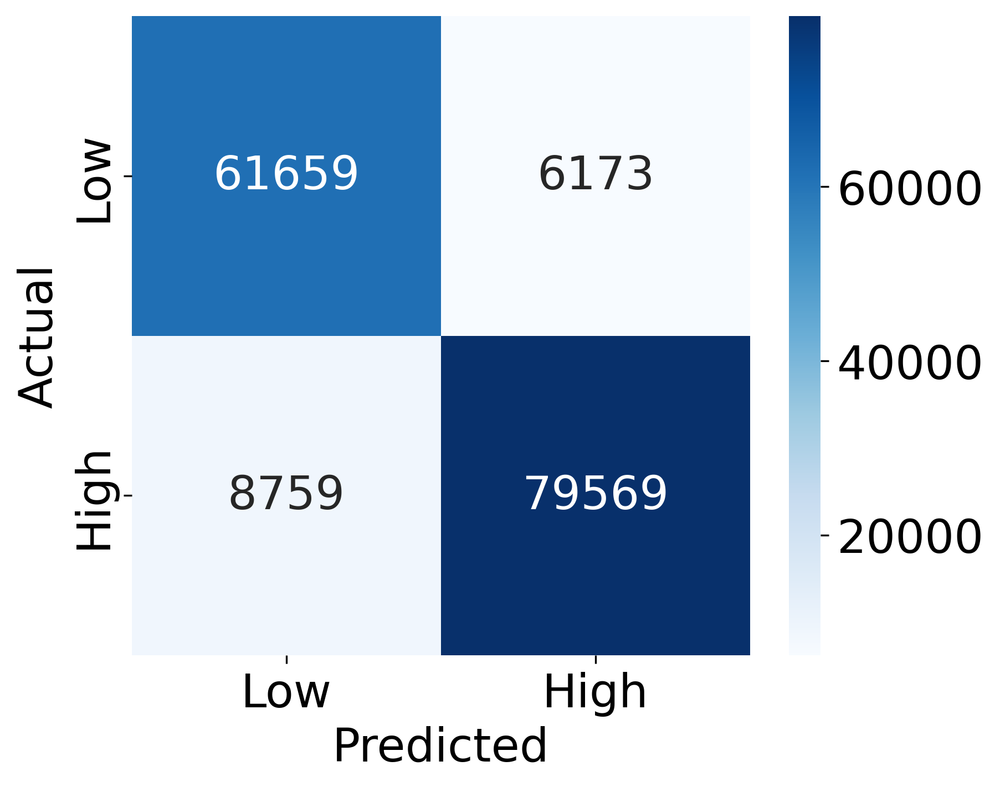

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Assuming y_true and y_pred are already defined and possibly one-hot encoded
y_true = np.array(y_test)
y_pred = model_loaded.predict(x_test)

# If y_true or y_pred are one-hot encoded, flatten them
y_true = np.argmax(y_true, axis=1)  # Convert to label indices if one-hot encoded
y_pred = np.argmax(y_pred, axis=1)  # Convert to label indices if one-hot encoded

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot confusion matrix using Seaborn heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Low', 'High'], yticklabels=['Low', 'High'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
# plt.title('Confusion Matrix')
plt.show()

4880/4880 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step


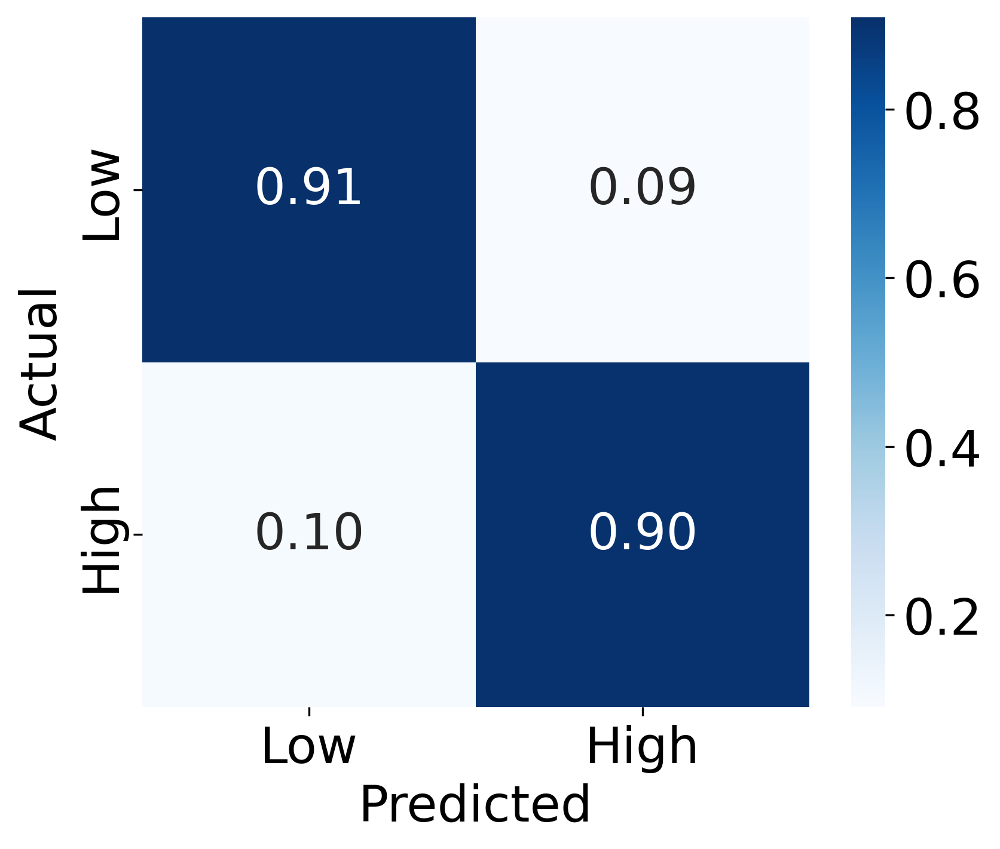

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Assuming y_true and y_pred are already defined and possibly one-hot encoded
y_true = np.array(y_test)
y_pred = model_loaded.predict(x_test)

# If y_true or y_pred are one-hot encoded, flatten them
y_true = np.argmax(y_true, axis=1)  # Convert to label indices if one-hot encoded
y_pred = np.argmax(y_pred, axis=1)  # Convert to label indices if one-hot encoded

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Normalize the confusion matrix
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Plot normalized confusion matrix using Seaborn heatmap
plt.figure(figsize=(6, 5))
ax = sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Blues',
                 xticklabels=['Low', 'High'],
                 yticklabels=['Low', 'High'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
#plt.title('Normalized Confusion Matrix')
plt.show()

# SHAP

In [ ]:
# Installing shap
!pip install shap

In [ ]:
# Import Shap
import shap

In [ ]:
# Reshape back to original 2D input for SHAP
X_train_shap = X_train.squeeze(-1)
x_test_shap = x_test.squeeze(-1)

In [ ]:
import shap
import os
import pickle
import numpy as np

# Define your drive path
drive_path = '/content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/'

# Function to save SHAP values incrementally
def save_shap_values(shap_values, file_name):
    file_path = os.path.join(drive_path, file_name)
    with open(file_path, 'wb') as f:
        pickle.dump(shap_values, f)
    print(f"Saved SHAP values to {file_path}")

# Function to load SHAP values (if any)
def load_shap_values(file_name):
    file_path = os.path.join(drive_path, file_name)
    if os.path.exists(file_path):
        with open(file_path, 'rb') as f:
            shap_values = pickle.load(f)
        print(f"Loaded SHAP values from {file_path}")
        return shap_values
    else:
        return None

# Function to compute SHAP values for a given data chunk
def compute_shap_chunk(data, explainer, start_idx, chunk_size=100):
    print(f"Computing SHAP values from index {start_idx} to {min(start_idx + chunk_size, data.shape[0])}")
    shap_values_chunk = explainer(data[start_idx:start_idx + chunk_size])
    return shap_values_chunk

# Define paths for saving progress
shap_values_train_file = 'shap_values_train.pkl'
shap_values_test_file = 'shap_values_test.pkl'

# Initialize SHAP explainer with masker
masker = shap.maskers.Independent(X_train_shap)
explainer = shap.Explainer(model_loaded, masker)

# Load previously saved SHAP values
shap_values_train_existing = load_shap_values(shap_values_train_file)
shap_values_test_existing = load_shap_values(shap_values_test_file)

# Get the current index to resume from (if there's existing data)
train_start_idx = 0
test_start_idx = 0

if shap_values_train_existing is not None:
    train_start_idx = len(shap_values_train_existing.values)
    print(f"Resuming from index {train_start_idx} for training set...")

if shap_values_test_existing is not None:
    test_start_idx = len(shap_values_test_existing.values)
    print(f"Resuming from index {test_start_idx} for test set...")

# Compute SHAP values in chunks
chunk_size = 100  # You can adjust the chunk size based on your system memory and data size

# Compute for the training set
if shap_values_train_existing is None:
    print("Computing SHAP values for the training set...")
    shap_values_train = None  # Start with None to initialize later
    for start_idx in range(train_start_idx, X_train_shap.shape[0], chunk_size):
        shap_values_chunk = compute_shap_chunk(X_train_shap, explainer, start_idx, chunk_size)
        if shap_values_train is None:  # Initialize with the first chunk
            shap_values_train = shap_values_chunk
        else:
            # Safely concatenate Explanation objects
            shap_values_train.values = np.concatenate([shap_values_train.values, shap_values_chunk.values], axis=0)
            shap_values_train.base_values = np.concatenate([shap_values_train.base_values, shap_values_chunk.base_values], axis=0)
            if shap_values_train.data is not None and shap_values_chunk.data is not None:
                shap_values_train.data = np.concatenate([shap_values_train.data, shap_values_chunk.data], axis=0)
        save_shap_values(shap_values_train, shap_values_train_file)
else:
    print("Resuming SHAP computation for the training set...")
    shap_values_train = shap_values_train_existing

# Compute for the test set
if shap_values_test_existing is None:
    print("Computing SHAP values for the test set...")
    shap_values_test = None  # Start with None to initialize later
    for start_idx in range(test_start_idx, x_test_shap.shape[0], chunk_size):
        shap_values_chunk = compute_shap_chunk(x_test_shap, explainer, start_idx, chunk_size)
        if shap_values_test is None:  # Initialize with the first chunk
            shap_values_test = shap_values_chunk
        else:
            # Safely concatenate Explanation objects
            shap_values_test.values = np.concatenate([shap_values_test.values, shap_values_chunk.values], axis=0)
            shap_values_test.base_values = np.concatenate([shap_values_test.base_values, shap_values_chunk.base_values], axis=0)
            if shap_values_test.data is not None and shap_values_chunk.data is not None:
                shap_values_test.data = np.concatenate([shap_values_test.data, shap_values_chunk.data], axis=0)
        save_shap_values(shap_values_test, shap_values_test_file)
else:
    print("Resuming SHAP computation for the test set...")
    shap_values_test = shap_values_test_existing

Loaded SHAP values from /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_train.pkl
Resuming from index 23900 for training set...
Resuming SHAP computation for the training set...
Computing SHAP values for the test set...
Computing SHAP values from index 0 to 100


PermutationExplainer explainer: 101it [00:27,  3.16it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100 to 200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 200 to 300


PermutationExplainer explainer: 101it [00:20,  2.57it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 300 to 400


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 400 to 500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 500 to 600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 600 to 700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 700 to 800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 800 to 900


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 900 to 1000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1000 to 1100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1100 to 1200


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1200 to 1300


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1300 to 1400


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1400 to 1500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1500 to 1600


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1600 to 1700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1700 to 1800


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1800 to 1900


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 1900 to 2000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2000 to 2100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2100 to 2200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2200 to 2300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2300 to 2400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2400 to 2500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2500 to 2600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2600 to 2700


PermutationExplainer explainer: 101it [00:20,  2.55it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2700 to 2800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2800 to 2900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 2900 to 3000


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3000 to 3100


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3100 to 3200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3200 to 3300


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3300 to 3400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3400 to 3500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3500 to 3600


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3600 to 3700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3700 to 3800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3800 to 3900


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 3900 to 4000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4000 to 4100


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4100 to 4200


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4200 to 4300


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4300 to 4400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4400 to 4500


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4500 to 4600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4600 to 4700


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4700 to 4800


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4800 to 4900


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 4900 to 5000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5000 to 5100


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5100 to 5200


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5200 to 5300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5300 to 5400


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5400 to 5500


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5500 to 5600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5600 to 5700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5700 to 5800


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5800 to 5900


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 5900 to 6000


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6000 to 6100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6100 to 6200


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6200 to 6300


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6300 to 6400


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6400 to 6500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6500 to 6600


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6600 to 6700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6700 to 6800


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6800 to 6900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 6900 to 7000


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7000 to 7100


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7100 to 7200


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7200 to 7300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7300 to 7400


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7400 to 7500


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7500 to 7600


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7600 to 7700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7700 to 7800


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7800 to 7900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 7900 to 8000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8000 to 8100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8100 to 8200


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8200 to 8300


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8300 to 8400


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8400 to 8500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8500 to 8600


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8600 to 8700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8700 to 8800


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8800 to 8900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 8900 to 9000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9000 to 9100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9100 to 9200


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9200 to 9300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9300 to 9400


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9400 to 9500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9500 to 9600


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9600 to 9700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9700 to 9800


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9800 to 9900


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 9900 to 10000


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10000 to 10100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10100 to 10200


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10200 to 10300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10300 to 10400


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10400 to 10500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10500 to 10600


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10600 to 10700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10700 to 10800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10800 to 10900


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 10900 to 11000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11000 to 11100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11100 to 11200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11200 to 11300


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11300 to 11400


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11400 to 11500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11500 to 11600


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11600 to 11700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11700 to 11800


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11800 to 11900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 11900 to 12000


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12000 to 12100


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12100 to 12200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12200 to 12300


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12300 to 12400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12400 to 12500


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12500 to 12600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12600 to 12700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12700 to 12800


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12800 to 12900


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 12900 to 13000


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13000 to 13100


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13100 to 13200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13200 to 13300


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13300 to 13400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13400 to 13500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13500 to 13600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13600 to 13700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13700 to 13800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13800 to 13900


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 13900 to 14000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14000 to 14100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14100 to 14200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14200 to 14300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14300 to 14400


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14400 to 14500


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14500 to 14600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14600 to 14700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14700 to 14800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14800 to 14900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 14900 to 15000


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15000 to 15100


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15100 to 15200


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15200 to 15300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15300 to 15400


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15400 to 15500


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15500 to 15600


PermutationExplainer explainer: 101it [00:15,  2.38it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15600 to 15700


PermutationExplainer explainer: 101it [00:16,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15700 to 15800


PermutationExplainer explainer: 101it [00:16,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15800 to 15900


PermutationExplainer explainer: 101it [00:15,  2.35it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 15900 to 16000


PermutationExplainer explainer: 101it [00:16,  2.37it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16000 to 16100


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16100 to 16200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16200 to 16300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16300 to 16400


PermutationExplainer explainer: 101it [00:15,  2.33it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16400 to 16500


PermutationExplainer explainer: 101it [00:16,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16500 to 16600


PermutationExplainer explainer: 101it [00:16,  2.39it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16600 to 16700


PermutationExplainer explainer: 101it [00:15,  2.32it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16700 to 16800


PermutationExplainer explainer: 101it [00:16,  2.38it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16800 to 16900


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 16900 to 17000


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17000 to 17100


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17100 to 17200


PermutationExplainer explainer: 101it [00:15,  2.30it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17200 to 17300


PermutationExplainer explainer: 101it [00:16,  2.38it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17300 to 17400


PermutationExplainer explainer: 101it [00:15,  2.31it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17400 to 17500


PermutationExplainer explainer: 101it [00:15,  2.31it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17500 to 17600


PermutationExplainer explainer: 101it [00:16,  2.34it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17600 to 17700


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17700 to 17800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17800 to 17900


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 17900 to 18000


PermutationExplainer explainer: 101it [00:15,  2.35it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18000 to 18100


PermutationExplainer explainer: 101it [00:16,  2.38it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18100 to 18200


PermutationExplainer explainer: 101it [00:16,  2.37it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18200 to 18300


PermutationExplainer explainer: 101it [00:15,  2.29it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18300 to 18400


PermutationExplainer explainer: 101it [00:15,  2.32it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18400 to 18500


PermutationExplainer explainer: 101it [00:20,  2.55it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18500 to 18600


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18600 to 18700


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18700 to 18800


PermutationExplainer explainer: 101it [00:15,  2.34it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18800 to 18900


PermutationExplainer explainer: 101it [00:16,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 18900 to 19000


PermutationExplainer explainer: 101it [00:16,  2.37it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19000 to 19100


PermutationExplainer explainer: 101it [00:15,  2.34it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19100 to 19200


PermutationExplainer explainer: 101it [00:16,  2.30it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19200 to 19300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19300 to 19400


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19400 to 19500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19500 to 19600


PermutationExplainer explainer: 101it [00:15,  2.28it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19600 to 19700


PermutationExplainer explainer: 101it [00:16,  2.36it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19700 to 19800


PermutationExplainer explainer: 101it [00:16,  2.35it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19800 to 19900


PermutationExplainer explainer: 101it [00:15,  2.35it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 19900 to 20000


PermutationExplainer explainer: 101it [00:16,  2.31it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20000 to 20100


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20100 to 20200


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20200 to 20300


PermutationExplainer explainer: 101it [00:15,  2.27it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20300 to 20400


PermutationExplainer explainer: 101it [00:16,  2.38it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20400 to 20500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20500 to 20600


PermutationExplainer explainer: 101it [00:15,  2.33it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20600 to 20700


PermutationExplainer explainer: 101it [00:16,  2.30it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20700 to 20800


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20800 to 20900


PermutationExplainer explainer: 101it [00:15,  2.30it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 20900 to 21000


PermutationExplainer explainer: 101it [00:16,  2.38it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21000 to 21100


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21100 to 21200


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21200 to 21300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21300 to 21400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21400 to 21500


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21500 to 21600


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21600 to 21700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21700 to 21800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21800 to 21900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 21900 to 22000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22000 to 22100


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22100 to 22200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22200 to 22300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22300 to 22400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22400 to 22500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22500 to 22600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22600 to 22700


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22700 to 22800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22800 to 22900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 22900 to 23000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23000 to 23100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23100 to 23200


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23200 to 23300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23300 to 23400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23400 to 23500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23500 to 23600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23600 to 23700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23700 to 23800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23800 to 23900


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 23900 to 24000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24000 to 24100


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24100 to 24200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24200 to 24300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24300 to 24400


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24400 to 24500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24500 to 24600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24600 to 24700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24700 to 24800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24800 to 24900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 24900 to 25000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25000 to 25100


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25100 to 25200


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25200 to 25300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25300 to 25400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25400 to 25500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25500 to 25600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25600 to 25700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25700 to 25800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25800 to 25900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 25900 to 26000


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26000 to 26100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26100 to 26200


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26200 to 26300


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26300 to 26400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26400 to 26500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26500 to 26600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26600 to 26700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26700 to 26800


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26800 to 26900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 26900 to 27000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27000 to 27100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27100 to 27200


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27200 to 27300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27300 to 27400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27400 to 27500


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27500 to 27600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27600 to 27700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27700 to 27800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27800 to 27900


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 27900 to 28000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28000 to 28100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28100 to 28200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28200 to 28300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28300 to 28400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28400 to 28500


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28500 to 28600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28600 to 28700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28700 to 28800


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28800 to 28900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 28900 to 29000


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29000 to 29100


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29100 to 29200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29200 to 29300


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29300 to 29400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29400 to 29500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29500 to 29600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29600 to 29700


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29700 to 29800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29800 to 29900


PermutationExplainer explainer: 101it [00:19,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 29900 to 30000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30000 to 30100


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30100 to 30200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30200 to 30300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30300 to 30400


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30400 to 30500


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30500 to 30600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30600 to 30700


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30700 to 30800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30800 to 30900


PermutationExplainer explainer: 101it [00:19,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 30900 to 31000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31000 to 31100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31100 to 31200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31200 to 31300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31300 to 31400


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31400 to 31500


PermutationExplainer explainer: 101it [00:19,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31500 to 31600


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31600 to 31700


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31700 to 31800


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31800 to 31900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 31900 to 32000


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32000 to 32100


PermutationExplainer explainer: 101it [00:19,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32100 to 32200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32200 to 32300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32300 to 32400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32400 to 32500


PermutationExplainer explainer: 101it [00:19,  2.55it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32500 to 32600


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32600 to 32700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32700 to 32800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32800 to 32900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 32900 to 33000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33000 to 33100


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33100 to 33200


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33200 to 33300


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33300 to 33400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33400 to 33500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33500 to 33600


PermutationExplainer explainer: 101it [00:19,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33600 to 33700


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33700 to 33800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33800 to 33900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 33900 to 34000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34000 to 34100


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34100 to 34200


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34200 to 34300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34300 to 34400


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34400 to 34500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34500 to 34600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34600 to 34700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34700 to 34800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34800 to 34900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 34900 to 35000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35000 to 35100


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35100 to 35200


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35200 to 35300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35300 to 35400


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35400 to 35500


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35500 to 35600


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35600 to 35700


PermutationExplainer explainer: 101it [00:20,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35700 to 35800


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35800 to 35900


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 35900 to 36000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36000 to 36100


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36100 to 36200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36200 to 36300


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36300 to 36400


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36400 to 36500


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36500 to 36600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36600 to 36700


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36700 to 36800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36800 to 36900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 36900 to 37000


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37000 to 37100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37100 to 37200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37200 to 37300


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37300 to 37400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37400 to 37500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37500 to 37600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37600 to 37700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37700 to 37800


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37800 to 37900


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 37900 to 38000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38000 to 38100


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38100 to 38200


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38200 to 38300


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38300 to 38400


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38400 to 38500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38500 to 38600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38600 to 38700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38700 to 38800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38800 to 38900


PermutationExplainer explainer: 101it [00:20,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 38900 to 39000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39000 to 39100


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39100 to 39200


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39200 to 39300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39300 to 39400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39400 to 39500


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39500 to 39600


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39600 to 39700


PermutationExplainer explainer: 101it [00:19,  2.55it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39700 to 39800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39800 to 39900


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 39900 to 40000


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40000 to 40100


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40100 to 40200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40200 to 40300


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40300 to 40400


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40400 to 40500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40500 to 40600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40600 to 40700


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40700 to 40800


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40800 to 40900


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 40900 to 41000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41000 to 41100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41100 to 41200


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41200 to 41300


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41300 to 41400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41400 to 41500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41500 to 41600


PermutationExplainer explainer: 101it [00:20,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41600 to 41700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41700 to 41800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41800 to 41900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 41900 to 42000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42000 to 42100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42100 to 42200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42200 to 42300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42300 to 42400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42400 to 42500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42500 to 42600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42600 to 42700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42700 to 42800


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42800 to 42900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 42900 to 43000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43000 to 43100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43100 to 43200


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43200 to 43300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43300 to 43400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43400 to 43500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43500 to 43600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43600 to 43700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43700 to 43800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43800 to 43900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 43900 to 44000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44000 to 44100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44100 to 44200


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44200 to 44300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44300 to 44400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44400 to 44500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44500 to 44600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44600 to 44700


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44700 to 44800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44800 to 44900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 44900 to 45000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45000 to 45100


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45100 to 45200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45200 to 45300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45300 to 45400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45400 to 45500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45500 to 45600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45600 to 45700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45700 to 45800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45800 to 45900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 45900 to 46000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46000 to 46100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46100 to 46200


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46200 to 46300


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46300 to 46400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46400 to 46500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46500 to 46600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46600 to 46700


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46700 to 46800


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46800 to 46900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 46900 to 47000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47000 to 47100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47100 to 47200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47200 to 47300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47300 to 47400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47400 to 47500


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47500 to 47600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47600 to 47700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47700 to 47800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47800 to 47900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 47900 to 48000


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48000 to 48100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48100 to 48200


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48200 to 48300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48300 to 48400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48400 to 48500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48500 to 48600


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48600 to 48700


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48700 to 48800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48800 to 48900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 48900 to 49000


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49000 to 49100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49100 to 49200


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49200 to 49300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49300 to 49400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49400 to 49500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49500 to 49600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49600 to 49700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49700 to 49800


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49800 to 49900


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 49900 to 50000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50000 to 50100


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50100 to 50200


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50200 to 50300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50300 to 50400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50400 to 50500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50500 to 50600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50600 to 50700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50700 to 50800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50800 to 50900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 50900 to 51000


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51000 to 51100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51100 to 51200


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51200 to 51300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51300 to 51400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51400 to 51500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51500 to 51600


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51600 to 51700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51700 to 51800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51800 to 51900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 51900 to 52000


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52000 to 52100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52100 to 52200


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52200 to 52300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52300 to 52400


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52400 to 52500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52500 to 52600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52600 to 52700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52700 to 52800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52800 to 52900


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 52900 to 53000


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53000 to 53100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53100 to 53200


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53200 to 53300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53300 to 53400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53400 to 53500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53500 to 53600


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53600 to 53700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53700 to 53800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53800 to 53900


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 53900 to 54000


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54000 to 54100


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54100 to 54200


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54200 to 54300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54300 to 54400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54400 to 54500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54500 to 54600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54600 to 54700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54700 to 54800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54800 to 54900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 54900 to 55000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55000 to 55100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55100 to 55200


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55200 to 55300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55300 to 55400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55400 to 55500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55500 to 55600


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55600 to 55700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55700 to 55800


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55800 to 55900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 55900 to 56000


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56000 to 56100


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56100 to 56200


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56200 to 56300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56300 to 56400


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56400 to 56500


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56500 to 56600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56600 to 56700


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56700 to 56800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56800 to 56900


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 56900 to 57000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57000 to 57100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57100 to 57200


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57200 to 57300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57300 to 57400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57400 to 57500


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57500 to 57600


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57600 to 57700


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57700 to 57800


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57800 to 57900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 57900 to 58000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58000 to 58100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58100 to 58200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58200 to 58300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58300 to 58400


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58400 to 58500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58500 to 58600


PermutationExplainer explainer: 101it [00:20,  2.61it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58600 to 58700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58700 to 58800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58800 to 58900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 58900 to 59000


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59000 to 59100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59100 to 59200


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59200 to 59300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59300 to 59400


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59400 to 59500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59500 to 59600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59600 to 59700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59700 to 59800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59800 to 59900


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 59900 to 60000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60000 to 60100


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60100 to 60200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60200 to 60300


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60300 to 60400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60400 to 60500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60500 to 60600


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60600 to 60700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60700 to 60800


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60800 to 60900


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 60900 to 61000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61000 to 61100


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61100 to 61200


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61200 to 61300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61300 to 61400


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61400 to 61500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61500 to 61600


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61600 to 61700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61700 to 61800


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61800 to 61900


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 61900 to 62000


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62000 to 62100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62100 to 62200


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62200 to 62300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62300 to 62400


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62400 to 62500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62500 to 62600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62600 to 62700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62700 to 62800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62800 to 62900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 62900 to 63000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63000 to 63100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63100 to 63200


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63200 to 63300


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63300 to 63400


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63400 to 63500


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63500 to 63600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63600 to 63700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63700 to 63800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63800 to 63900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 63900 to 64000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64000 to 64100


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64100 to 64200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64200 to 64300


PermutationExplainer explainer: 101it [00:19,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64300 to 64400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64400 to 64500


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64500 to 64600


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64600 to 64700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64700 to 64800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64800 to 64900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 64900 to 65000


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65000 to 65100


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65100 to 65200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65200 to 65300


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65300 to 65400


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65400 to 65500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65500 to 65600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65600 to 65700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65700 to 65800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65800 to 65900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 65900 to 66000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66000 to 66100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66100 to 66200


PermutationExplainer explainer: 101it [00:20,  2.41it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66200 to 66300


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66300 to 66400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66400 to 66500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66500 to 66600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66600 to 66700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66700 to 66800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66800 to 66900


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 66900 to 67000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67000 to 67100


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67100 to 67200


PermutationExplainer explainer: 101it [00:19,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67200 to 67300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67300 to 67400


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67400 to 67500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67500 to 67600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67600 to 67700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67700 to 67800


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67800 to 67900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 67900 to 68000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68000 to 68100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68100 to 68200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68200 to 68300


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68300 to 68400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68400 to 68500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68500 to 68600


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68600 to 68700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68700 to 68800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68800 to 68900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 68900 to 69000


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69000 to 69100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69100 to 69200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69200 to 69300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69300 to 69400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69400 to 69500


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69500 to 69600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69600 to 69700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69700 to 69800


PermutationExplainer explainer: 101it [00:20,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69800 to 69900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 69900 to 70000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70000 to 70100


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70100 to 70200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70200 to 70300


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70300 to 70400


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70400 to 70500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70500 to 70600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70600 to 70700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70700 to 70800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70800 to 70900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 70900 to 71000


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71000 to 71100


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71100 to 71200


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71200 to 71300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71300 to 71400


PermutationExplainer explainer: 101it [00:19,  2.56it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71400 to 71500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71500 to 71600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71600 to 71700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71700 to 71800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71800 to 71900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 71900 to 72000


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72000 to 72100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72100 to 72200


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72200 to 72300


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72300 to 72400


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72400 to 72500


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72500 to 72600


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72600 to 72700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72700 to 72800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72800 to 72900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 72900 to 73000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73000 to 73100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73100 to 73200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73200 to 73300


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73300 to 73400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73400 to 73500


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73500 to 73600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73600 to 73700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73700 to 73800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73800 to 73900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 73900 to 74000


PermutationExplainer explainer: 101it [00:20,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74000 to 74100


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74100 to 74200


PermutationExplainer explainer: 101it [00:19,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74200 to 74300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74300 to 74400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74400 to 74500


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74500 to 74600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74600 to 74700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74700 to 74800


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74800 to 74900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 74900 to 75000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75000 to 75100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75100 to 75200


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75200 to 75300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75300 to 75400


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75400 to 75500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75500 to 75600


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75600 to 75700


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75700 to 75800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75800 to 75900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 75900 to 76000


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76000 to 76100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76100 to 76200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76200 to 76300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76300 to 76400


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76400 to 76500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76500 to 76600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76600 to 76700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76700 to 76800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76800 to 76900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 76900 to 77000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77000 to 77100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77100 to 77200


PermutationExplainer explainer: 101it [00:19,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77200 to 77300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77300 to 77400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77400 to 77500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77500 to 77600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77600 to 77700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77700 to 77800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77800 to 77900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 77900 to 78000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78000 to 78100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78100 to 78200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78200 to 78300


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78300 to 78400


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78400 to 78500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78500 to 78600


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78600 to 78700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78700 to 78800


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78800 to 78900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 78900 to 79000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79000 to 79100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79100 to 79200


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79200 to 79300


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79300 to 79400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79400 to 79500


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79500 to 79600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79600 to 79700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79700 to 79800


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79800 to 79900


PermutationExplainer explainer: 101it [00:19,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 79900 to 80000


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80000 to 80100


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80100 to 80200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80200 to 80300


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80300 to 80400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80400 to 80500


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80500 to 80600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80600 to 80700


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80700 to 80800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80800 to 80900


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 80900 to 81000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81000 to 81100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81100 to 81200


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81200 to 81300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81300 to 81400


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81400 to 81500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81500 to 81600


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81600 to 81700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81700 to 81800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81800 to 81900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 81900 to 82000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82000 to 82100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82100 to 82200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82200 to 82300


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82300 to 82400


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82400 to 82500


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82500 to 82600


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82600 to 82700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82700 to 82800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82800 to 82900


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 82900 to 83000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83000 to 83100


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83100 to 83200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83200 to 83300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83300 to 83400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83400 to 83500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83500 to 83600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83600 to 83700


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83700 to 83800


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83800 to 83900


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 83900 to 84000


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84000 to 84100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84100 to 84200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84200 to 84300


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84300 to 84400


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84400 to 84500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84500 to 84600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84600 to 84700


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84700 to 84800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84800 to 84900


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 84900 to 85000


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85000 to 85100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85100 to 85200


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85200 to 85300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85300 to 85400


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85400 to 85500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85500 to 85600


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85600 to 85700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85700 to 85800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85800 to 85900


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 85900 to 86000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86000 to 86100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86100 to 86200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86200 to 86300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86300 to 86400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86400 to 86500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86500 to 86600


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86600 to 86700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86700 to 86800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86800 to 86900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 86900 to 87000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87000 to 87100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87100 to 87200


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87200 to 87300


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87300 to 87400


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87400 to 87500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87500 to 87600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87600 to 87700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87700 to 87800


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87800 to 87900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 87900 to 88000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88000 to 88100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88100 to 88200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88200 to 88300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88300 to 88400


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88400 to 88500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88500 to 88600


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88600 to 88700


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88700 to 88800


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88800 to 88900


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 88900 to 89000


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89000 to 89100


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89100 to 89200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89200 to 89300


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89300 to 89400


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89400 to 89500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89500 to 89600


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89600 to 89700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89700 to 89800


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89800 to 89900


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 89900 to 90000


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90000 to 90100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90100 to 90200


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90200 to 90300


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90300 to 90400


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90400 to 90500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90500 to 90600


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90600 to 90700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90700 to 90800


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90800 to 90900


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 90900 to 91000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91000 to 91100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91100 to 91200


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91200 to 91300


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91300 to 91400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91400 to 91500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91500 to 91600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91600 to 91700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91700 to 91800


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91800 to 91900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 91900 to 92000


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92000 to 92100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92100 to 92200


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92200 to 92300


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92300 to 92400


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92400 to 92500


PermutationExplainer explainer: 101it [00:19,  2.56it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92500 to 92600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92600 to 92700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92700 to 92800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92800 to 92900


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 92900 to 93000


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93000 to 93100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93100 to 93200


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93200 to 93300


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93300 to 93400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93400 to 93500


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93500 to 93600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93600 to 93700


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93700 to 93800


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93800 to 93900


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 93900 to 94000


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94000 to 94100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94100 to 94200


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94200 to 94300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94300 to 94400


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94400 to 94500


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94500 to 94600


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94600 to 94700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94700 to 94800


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94800 to 94900


PermutationExplainer explainer: 101it [00:19,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 94900 to 95000


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95000 to 95100


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95100 to 95200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95200 to 95300


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95300 to 95400


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95400 to 95500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95500 to 95600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95600 to 95700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95700 to 95800


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95800 to 95900


PermutationExplainer explainer: 101it [00:20,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 95900 to 96000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96000 to 96100


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96100 to 96200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96200 to 96300


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96300 to 96400


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96400 to 96500


PermutationExplainer explainer: 101it [00:19,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96500 to 96600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96600 to 96700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96700 to 96800


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96800 to 96900


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 96900 to 97000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97000 to 97100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97100 to 97200


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97200 to 97300


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97300 to 97400


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97400 to 97500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97500 to 97600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97600 to 97700


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97700 to 97800


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97800 to 97900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 97900 to 98000


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98000 to 98100


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98100 to 98200


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98200 to 98300


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98300 to 98400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98400 to 98500


PermutationExplainer explainer: 101it [00:19,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98500 to 98600


PermutationExplainer explainer: 101it [00:19,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98600 to 98700


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98700 to 98800


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98800 to 98900


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 98900 to 99000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99000 to 99100


PermutationExplainer explainer: 101it [00:24,  2.85it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99100 to 99200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99200 to 99300


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99300 to 99400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99400 to 99500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99500 to 99600


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99600 to 99700


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99700 to 99800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99800 to 99900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 99900 to 100000


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100000 to 100100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100100 to 100200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100200 to 100300


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100300 to 100400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100400 to 100500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100500 to 100600


PermutationExplainer explainer: 101it [00:20,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100600 to 100700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100700 to 100800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100800 to 100900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 100900 to 101000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101000 to 101100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101100 to 101200


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101200 to 101300


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101300 to 101400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101400 to 101500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101500 to 101600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101600 to 101700


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101700 to 101800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101800 to 101900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 101900 to 102000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102000 to 102100


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102100 to 102200


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102200 to 102300


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102300 to 102400


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102400 to 102500


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102500 to 102600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102600 to 102700


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102700 to 102800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102800 to 102900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 102900 to 103000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103000 to 103100


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103100 to 103200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103200 to 103300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103300 to 103400


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103400 to 103500


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103500 to 103600


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103600 to 103700


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103700 to 103800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103800 to 103900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 103900 to 104000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104000 to 104100


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104100 to 104200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104200 to 104300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104300 to 104400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104400 to 104500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104500 to 104600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104600 to 104700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104700 to 104800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104800 to 104900


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 104900 to 105000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105000 to 105100


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105100 to 105200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105200 to 105300


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105300 to 105400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105400 to 105500


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105500 to 105600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105600 to 105700


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105700 to 105800


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105800 to 105900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 105900 to 106000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106000 to 106100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106100 to 106200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106200 to 106300


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106300 to 106400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106400 to 106500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106500 to 106600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106600 to 106700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106700 to 106800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106800 to 106900


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 106900 to 107000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107000 to 107100


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107100 to 107200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107200 to 107300


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107300 to 107400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107400 to 107500


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107500 to 107600


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107600 to 107700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107700 to 107800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107800 to 107900


PermutationExplainer explainer: 101it [00:20,  2.41it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 107900 to 108000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108000 to 108100


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108100 to 108200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108200 to 108300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108300 to 108400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108400 to 108500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108500 to 108600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108600 to 108700


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108700 to 108800


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108800 to 108900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 108900 to 109000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109000 to 109100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109100 to 109200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109200 to 109300


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109300 to 109400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109400 to 109500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109500 to 109600


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109600 to 109700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109700 to 109800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109800 to 109900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 109900 to 110000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110000 to 110100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110100 to 110200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110200 to 110300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110300 to 110400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110400 to 110500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110500 to 110600


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110600 to 110700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110700 to 110800


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110800 to 110900


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 110900 to 111000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111000 to 111100


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111100 to 111200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111200 to 111300


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111300 to 111400


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111400 to 111500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111500 to 111600


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111600 to 111700


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111700 to 111800


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111800 to 111900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 111900 to 112000


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112000 to 112100


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112100 to 112200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112200 to 112300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112300 to 112400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112400 to 112500


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112500 to 112600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112600 to 112700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112700 to 112800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112800 to 112900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 112900 to 113000


PermutationExplainer explainer: 101it [00:20,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113000 to 113100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113100 to 113200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113200 to 113300


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113300 to 113400


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113400 to 113500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113500 to 113600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113600 to 113700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113700 to 113800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113800 to 113900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 113900 to 114000


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114000 to 114100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114100 to 114200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114200 to 114300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114300 to 114400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114400 to 114500


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114500 to 114600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114600 to 114700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114700 to 114800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114800 to 114900


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 114900 to 115000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115000 to 115100


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115100 to 115200


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115200 to 115300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115300 to 115400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115400 to 115500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115500 to 115600


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115600 to 115700


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115700 to 115800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115800 to 115900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 115900 to 116000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116000 to 116100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116100 to 116200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116200 to 116300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116300 to 116400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116400 to 116500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116500 to 116600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116600 to 116700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116700 to 116800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116800 to 116900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 116900 to 117000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117000 to 117100


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117100 to 117200


PermutationExplainer explainer: 101it [00:20,  2.56it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117200 to 117300


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117300 to 117400


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117400 to 117500


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117500 to 117600


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117600 to 117700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117700 to 117800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117800 to 117900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 117900 to 118000


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118000 to 118100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118100 to 118200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118200 to 118300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118300 to 118400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118400 to 118500


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118500 to 118600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118600 to 118700


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118700 to 118800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118800 to 118900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 118900 to 119000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119000 to 119100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119100 to 119200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119200 to 119300


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119300 to 119400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119400 to 119500


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119500 to 119600


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119600 to 119700


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119700 to 119800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119800 to 119900


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 119900 to 120000


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120000 to 120100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120100 to 120200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120200 to 120300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120300 to 120400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120400 to 120500


PermutationExplainer explainer: 101it [00:20,  2.55it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120500 to 120600


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120600 to 120700


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120700 to 120800


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120800 to 120900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 120900 to 121000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121000 to 121100


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121100 to 121200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121200 to 121300


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121300 to 121400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121400 to 121500


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121500 to 121600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121600 to 121700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121700 to 121800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121800 to 121900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 121900 to 122000


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122000 to 122100


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122100 to 122200


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122200 to 122300


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122300 to 122400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122400 to 122500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122500 to 122600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122600 to 122700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122700 to 122800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122800 to 122900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 122900 to 123000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123000 to 123100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123100 to 123200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123200 to 123300


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123300 to 123400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123400 to 123500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123500 to 123600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123600 to 123700


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123700 to 123800


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123800 to 123900


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 123900 to 124000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124000 to 124100


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124100 to 124200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124200 to 124300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124300 to 124400


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124400 to 124500


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124500 to 124600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124600 to 124700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124700 to 124800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124800 to 124900


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 124900 to 125000


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125000 to 125100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125100 to 125200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125200 to 125300


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125300 to 125400


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125400 to 125500


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125500 to 125600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125600 to 125700


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125700 to 125800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125800 to 125900


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 125900 to 126000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126000 to 126100


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126100 to 126200


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126200 to 126300


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126300 to 126400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126400 to 126500


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126500 to 126600


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126600 to 126700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126700 to 126800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126800 to 126900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 126900 to 127000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127000 to 127100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127100 to 127200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127200 to 127300


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127300 to 127400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127400 to 127500


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127500 to 127600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127600 to 127700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127700 to 127800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127800 to 127900


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 127900 to 128000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128000 to 128100


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128100 to 128200


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128200 to 128300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128300 to 128400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128400 to 128500


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128500 to 128600


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128600 to 128700


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128700 to 128800


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128800 to 128900


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 128900 to 129000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129000 to 129100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129100 to 129200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129200 to 129300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129300 to 129400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129400 to 129500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129500 to 129600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129600 to 129700


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129700 to 129800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129800 to 129900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 129900 to 130000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130000 to 130100


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130100 to 130200


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130200 to 130300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130300 to 130400


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130400 to 130500


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130500 to 130600


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130600 to 130700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130700 to 130800


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130800 to 130900


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 130900 to 131000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131000 to 131100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131100 to 131200


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131200 to 131300


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131300 to 131400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131400 to 131500


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131500 to 131600


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131600 to 131700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131700 to 131800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131800 to 131900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 131900 to 132000


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132000 to 132100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132100 to 132200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132200 to 132300


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132300 to 132400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132400 to 132500


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132500 to 132600


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132600 to 132700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132700 to 132800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132800 to 132900


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 132900 to 133000


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133000 to 133100


PermutationExplainer explainer: 101it [00:20,  2.40it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133100 to 133200


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133200 to 133300


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133300 to 133400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133400 to 133500


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133500 to 133600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133600 to 133700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133700 to 133800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133800 to 133900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 133900 to 134000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134000 to 134100


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134100 to 134200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134200 to 134300


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134300 to 134400


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134400 to 134500


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134500 to 134600


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134600 to 134700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134700 to 134800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134800 to 134900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 134900 to 135000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135000 to 135100


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135100 to 135200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135200 to 135300


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135300 to 135400


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135400 to 135500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135500 to 135600


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135600 to 135700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135700 to 135800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135800 to 135900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 135900 to 136000


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136000 to 136100


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136100 to 136200


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136200 to 136300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136300 to 136400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136400 to 136500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136500 to 136600


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136600 to 136700


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136700 to 136800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136800 to 136900


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 136900 to 137000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137000 to 137100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137100 to 137200


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137200 to 137300


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137300 to 137400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137400 to 137500


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137500 to 137600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137600 to 137700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137700 to 137800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137800 to 137900


PermutationExplainer explainer: 101it [00:20,  2.54it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 137900 to 138000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138000 to 138100


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138100 to 138200


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138200 to 138300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138300 to 138400


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138400 to 138500


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138500 to 138600


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138600 to 138700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138700 to 138800


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138800 to 138900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 138900 to 139000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139000 to 139100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139100 to 139200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139200 to 139300


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139300 to 139400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139400 to 139500


PermutationExplainer explainer: 101it [00:21,  2.38it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139500 to 139600


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139600 to 139700


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139700 to 139800


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139800 to 139900


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 139900 to 140000


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140000 to 140100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140100 to 140200


PermutationExplainer explainer: 101it [00:20,  2.53it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140200 to 140300


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140300 to 140400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140400 to 140500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140500 to 140600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140600 to 140700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140700 to 140800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140800 to 140900


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 140900 to 141000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141000 to 141100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141100 to 141200


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141200 to 141300


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141300 to 141400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141400 to 141500


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141500 to 141600


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141600 to 141700


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141700 to 141800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141800 to 141900


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 141900 to 142000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142000 to 142100


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142100 to 142200


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142200 to 142300


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142300 to 142400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142400 to 142500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142500 to 142600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142600 to 142700


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142700 to 142800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142800 to 142900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 142900 to 143000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143000 to 143100


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143100 to 143200


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143200 to 143300


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143300 to 143400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143400 to 143500


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143500 to 143600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143600 to 143700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143700 to 143800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143800 to 143900


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 143900 to 144000


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144000 to 144100


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144100 to 144200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144200 to 144300


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144300 to 144400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144400 to 144500


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144500 to 144600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144600 to 144700


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144700 to 144800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144800 to 144900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 144900 to 145000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145000 to 145100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145100 to 145200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145200 to 145300


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145300 to 145400


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145400 to 145500


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145500 to 145600


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145600 to 145700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145700 to 145800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145800 to 145900


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 145900 to 146000


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146000 to 146100


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146100 to 146200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146200 to 146300


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146300 to 146400


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146400 to 146500


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146500 to 146600


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146600 to 146700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146700 to 146800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146800 to 146900


PermutationExplainer explainer: 101it [00:20,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 146900 to 147000


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147000 to 147100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147100 to 147200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147200 to 147300


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147300 to 147400


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147400 to 147500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147500 to 147600


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147600 to 147700


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147700 to 147800


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147800 to 147900


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 147900 to 148000


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148000 to 148100


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148100 to 148200


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148200 to 148300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148300 to 148400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148400 to 148500


PermutationExplainer explainer: 101it [00:21,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148500 to 148600


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148600 to 148700


PermutationExplainer explainer: 101it [00:20,  2.40it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148700 to 148800


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148800 to 148900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 148900 to 149000


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149000 to 149100


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149100 to 149200


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149200 to 149300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149300 to 149400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149400 to 149500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149500 to 149600


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149600 to 149700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149700 to 149800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149800 to 149900


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 149900 to 150000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150000 to 150100


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150100 to 150200


PermutationExplainer explainer: 101it [00:20,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150200 to 150300


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150300 to 150400


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150400 to 150500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150500 to 150600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150600 to 150700


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150700 to 150800


PermutationExplainer explainer: 101it [00:20,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150800 to 150900


PermutationExplainer explainer: 101it [00:20,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 150900 to 151000


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151000 to 151100


PermutationExplainer explainer: 101it [00:20,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151100 to 151200


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151200 to 151300


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151300 to 151400


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151400 to 151500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151500 to 151600


PermutationExplainer explainer: 101it [00:20,  2.43it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151600 to 151700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151700 to 151800


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151800 to 151900


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 151900 to 152000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152000 to 152100


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152100 to 152200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152200 to 152300


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152300 to 152400


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152400 to 152500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152500 to 152600


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152600 to 152700


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152700 to 152800


PermutationExplainer explainer: 101it [00:19,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152800 to 152900


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 152900 to 153000


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153000 to 153100


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153100 to 153200


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153200 to 153300


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153300 to 153400


PermutationExplainer explainer: 101it [00:20,  2.45it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153400 to 153500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153500 to 153600


PermutationExplainer explainer: 101it [00:20,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153600 to 153700


PermutationExplainer explainer: 101it [00:20,  2.39it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153700 to 153800


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153800 to 153900


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 153900 to 154000


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154000 to 154100


PermutationExplainer explainer: 101it [00:20,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154100 to 154200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154200 to 154300


PermutationExplainer explainer: 101it [00:20,  2.39it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154300 to 154400


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154400 to 154500


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154500 to 154600


PermutationExplainer explainer: 101it [00:20,  2.41it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154600 to 154700


PermutationExplainer explainer: 101it [00:19,  2.52it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154700 to 154800


PermutationExplainer explainer: 101it [00:19,  2.50it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154800 to 154900


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 154900 to 155000


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155000 to 155100


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155100 to 155200


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155200 to 155300


PermutationExplainer explainer: 101it [00:19,  2.46it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155300 to 155400


PermutationExplainer explainer: 101it [00:20,  2.44it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155400 to 155500


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155500 to 155600


PermutationExplainer explainer: 101it [00:20,  2.48it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155600 to 155700


PermutationExplainer explainer: 101it [00:19,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155700 to 155800


PermutationExplainer explainer: 101it [00:19,  2.51it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155800 to 155900


PermutationExplainer explainer: 101it [00:20,  2.42it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 155900 to 156000


PermutationExplainer explainer: 101it [00:20,  2.49it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 156000 to 156100


PermutationExplainer explainer: 101it [00:20,  2.47it/s]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl
Computing SHAP values from index 156100 to 156160


PermutationExplainer explainer: 61it [00:11,  1.19s/it]


Saved SHAP values to /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl


In [ ]:
import pickle
import os

# Define the path to your saved SHAP values
drive_path = '/content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/'
shap_values_train_file = 'shap_values_train.pkl'
shap_values_test_file = 'shap_values_test.pkl'

# Function to load SHAP values
def load_shap_values(file_name):
    file_path = os.path.join(drive_path, file_name)
    if os.path.exists(file_path):
        with open(file_path, 'rb') as f:
            shap_values = pickle.load(f)
        print(f"Loaded SHAP values from {file_path}")
        return shap_values
    else:
        print(f"No file found at {file_path}")
        return None

# Load training and test SHAP values
shap_values_train = load_shap_values(shap_values_train_file)
shap_values_test = load_shap_values(shap_values_test_file)

Loaded SHAP values from /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_train.pkl
Loaded SHAP values from /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_test.pkl


In [ ]:
# Drop the 'Valence' column and get the list of feature names
actual_feature_names = encoded_test.drop(columns=["Valence", "Arousal", "Dominance", "Liking"]).columns.tolist()

Loaded SHAP values from /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_train.pkl


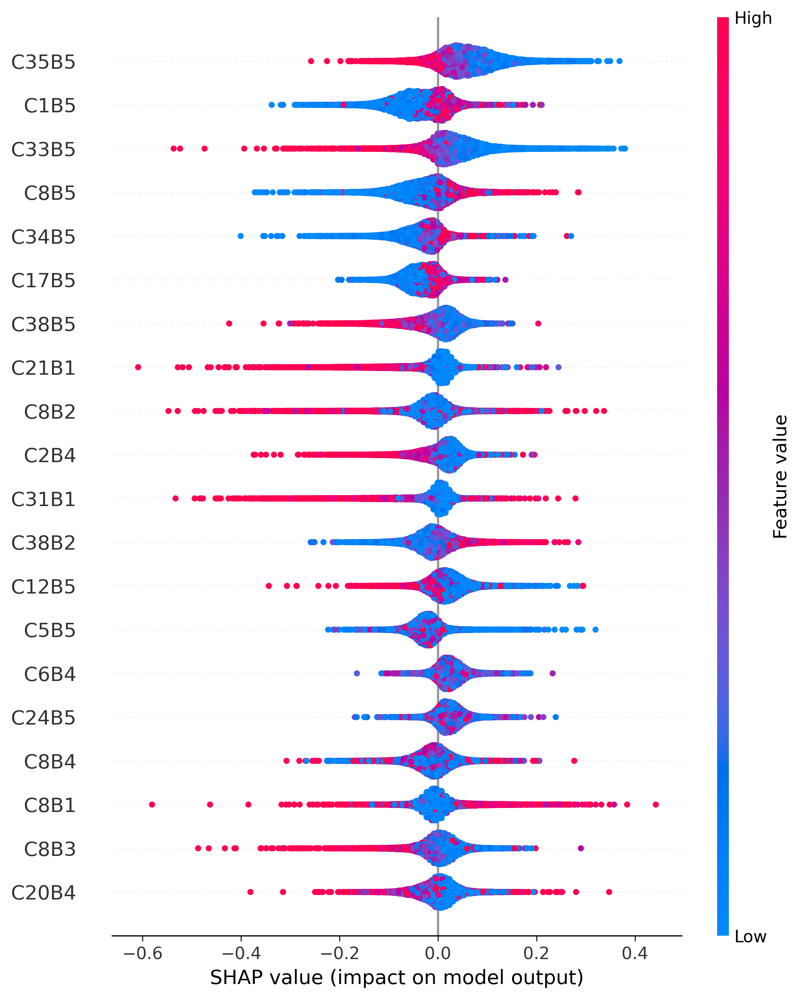

In [ ]:
# Load SHAP values and the corresponding data subset
shap_values_train = load_shap_values(shap_values_train_file)

# Assuming X_train_sample is the subset of training data
# Ensure X_train_sample is defined correctly and matches the data used during SHAP computation
X_train_sample = X_train_shap[:len(shap_values_train.values)]

# Use actual feature names from your dataset
feature_names = actual_feature_names  # Replace 'actual_feature_names' with the list of your dataset's feature names
X_train_sample_df = pd.DataFrame(X_train_sample, columns=feature_names)

# Extract SHAP values for the first class (or omit the index if single-class)
shap_values_train_sample = shap_values_train.values
shap_values_class_0 = shap_values_train_sample[:, :, 0]  # For the first class

# Generate a SHAP summary plot with actual feature names
shap.summary_plot(shap_values_class_0, X_train_sample_df)

In [ ]:
# Load SHAP values (replace with your actual loading function or method)
shap_values_train = load_shap_values(shap_values_train_file)

# Subset training data to match SHAP values
X_train_sample = X_train_shap[:len(shap_values_train.values)]

# Define actual feature names (ensure it includes all 203 features)
feature_names = actual_feature_names  # Replace with your dataset's feature names
X_train_sample_df = pd.DataFrame(X_train_sample, columns=feature_names)

# Extract SHAP values for the first class (or adjust if single-class)
shap_values_train_sample = shap_values_train.values
shap_values_class_0 = shap_values_train_sample[:, :, 0]  # For the first class

# Generate SHAP summary plot for all 203 features
shap.summary_plot(shap_values_class_0, X_train_sample_df, max_display=203)

Loaded SHAP values from /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_train.pkl


In [ ]:
# Load SHAP values (replace with your actual loading function or method)
shap_values_train = load_shap_values(shap_values_train_file)

# Subset training data to match SHAP values
X_train_sample = X_train_shap[:len(shap_values_train.values)]

# Define actual feature names (ensure it includes all 203 features)
feature_names = actual_feature_names  # Replace with your dataset's feature names
X_train_sample_df = pd.DataFrame(X_train_sample, columns=feature_names)

# Extract SHAP values for the first class (or adjust if single-class)
shap_values_train_sample = shap_values_train.values
shap_values_class_0 = shap_values_train_sample[:, :, 0]  # For the first class

# Generate SHAP summary plot for all 203 features
shap.summary_plot(shap_values_class_0, X_train_sample_df, max_display=203)

Loaded SHAP values from /content/drive/Shareddrives/Best Shared Drive Ever/EEG/DEAP-Dataset/EEG-Final/XAI/SHAP/SHAP-Updated/shap_values_train.pkl


In [ ]:
# Aggregate SHAP values for class 0 (mean absolute values across all samples)
shap_values_class_0_mean = np.abs(shap_values_class_0).mean(axis=0)

# Use actual feature names from your dataset
feature_names = actual_feature_names  # Replace 'actual_feature_names' with the list of your dataset's feature names
# Generate the SHAP bar plot for the top 203 features
shap.plots.bar(shap.Explanation(values=shap_values_class_0_mean,
                                feature_names=feature_names),
               max_display=203)

In [ ]:
# Aggregate SHAP values for class 0 (mean absolute values across all samples)
shap_values_class_0_mean = np.abs(shap_values_class_0).mean(axis=0)

# Use actual feature names from your dataset
feature_names = actual_feature_names  # Replace 'actual_feature_names' with the list of your dataset's feature names
# Generate the SHAP bar plot for the top 203 features
shap.plots.bar(shap.Explanation(values=shap_values_class_0_mean,
                                feature_names=feature_names),
               max_display=203)

In [ ]:
import numpy as np
import pandas as pd
from collections import defaultdict

threshold = 0.02

# Calculate the mean absolute SHAP values for class 0
shap_values_class_0_mean = np.abs(shap_values_class_0).mean(axis=0)

# Use actual feature names from your dataset
feature_names = np.array(actual_feature_names)  # Ensure feature names are in numpy array format

# Initialize a dictionary to store aggregated SHAP values for each prefix
prefix_shap_values = defaultdict(float)

# Aggregate SHAP values for columns with the same prefix (e.g., C1, C2, ..., C40)
for feature, shap_value in zip(feature_names, shap_values_class_0_mean):
    # Extract the prefix (assumes format like C1B1, C2B3, etc.)
    prefix = feature.split('B')[0]  # Keep the part before "B"
    prefix_shap_values[prefix] += shap_value

# Convert the dictionary to a DataFrame for easier sorting and visualization
prefix_shap_df = pd.DataFrame(list(prefix_shap_values.items()), columns=['Prefix', 'Aggregated_SHAP_Value'])

# Sort the DataFrame by the aggregated SHAP value in descending order
prefix_shap_df = prefix_shap_df.sort_values(by='Aggregated_SHAP_Value', ascending=False)

# Output the sorted DataFrame
print(prefix_shap_df)

# If you want the top N important prefixes
N = 25
top_prefixes = prefix_shap_df.head(N)
print(f"Top {N} Important Prefixes:\n", top_prefixes)

   Prefix  Aggregated_SHAP_Value
7      C8               0.154230
37    C38               0.135928
1      C2               0.126450
32    C33               0.124321
19    C20               0.123502
16    C17               0.122311
11    C12               0.119881
0      C1               0.118774
30    C31               0.112175
20    C21               0.107901
34    C35               0.107771
26    C27               0.101377
5      C6               0.099840
21    C22               0.098566
4      C5               0.096359
33    C34               0.094361
27    C28               0.091735
15    C16               0.091231
23    C24               0.090869
29    C30               0.089345
9     C10               0.088976
8      C9               0.087877
6      C7               0.087569
13    C14               0.084868
14    C15               0.083200
17    C18               0.082340
36    C37               0.081651
25    C26               0.081098
28    C29               0.079134
18    C19 

In [ ]:
# Calculate the mean absolute SHAP values for class 0
shap_values_class_0_mean = np.abs(shap_values_class_0).mean(axis=0)

# Use actual feature names from your dataset
feature_names = np.array(actual_feature_names)  # Ensure feature names are in numpy array format

# Filter features with SHAP values greater than or equal to 0.04
threshold = 0.04
important_features = feature_names[shap_values_class_0_mean >= threshold]

# Convert the resulting array to a list
important_features_list = important_features.tolist()

# Output the list
print(important_features_list)
print("Number of Important Features:", len(important_features_list))

['C1B5', 'C8B5', 'C33B5', 'C35B5']
Number of Important Features: 4


In [ ]:
# Calculate the mean absolute SHAP values for class 0
shap_values_class_0_mean = np.abs(shap_values_class_0).mean(axis=0)

# Use actual feature names from your dataset
feature_names = np.array(actual_feature_names)  # Ensure feature names are in numpy array format

# Filter features with SHAP values greater than or equal to 0.03
threshold = 0.03
important_features = feature_names[shap_values_class_0_mean >= threshold]

# Convert the resulting array to a list
important_features_list = important_features.tolist()

# Output the list
print(important_features_list)
print("Number of Important Features:", len(important_features_list))

['C1B5', 'C2B4', 'C8B2', 'C8B5', 'C17B5', 'C21B1', 'C33B5', 'C34B5', 'C35B5', 'C38B5']
Number of Important Features: 10


In [ ]:
# Calculate the mean absolute SHAP values for class 0
shap_values_class_0_mean = np.abs(shap_values_class_0).mean(axis=0)

# Use actual feature names from your dataset
feature_names = np.array(actual_feature_names)  # Ensure feature names are in numpy array format

# Filter features with SHAP values greater than or equal to 0.02
threshold = 0.02
important_features = feature_names[shap_values_class_0_mean >= threshold]

# Convert the resulting array to a list
important_features_list = important_features.tolist()

# Output the list
print(important_features_list)
print("Number of Important Features:", len(important_features_list))

['C1B4', 'C1B5', 'C2B1', 'C2B2', 'C2B3', 'C2B4', 'C2B5', 'C4B5', 'C5B5', 'C6B4', 'C6B5', 'C7B5', 'C8B1', 'C8B2', 'C8B3', 'C8B4', 'C8B5', 'C9B1', 'C12B1', 'C12B2', 'C12B3', 'C12B4', 'C12B5', 'C13B1', 'C16B5', 'C17B1', 'C17B3', 'C17B4', 'C17B5', 'C20B1', 'C20B2', 'C20B3', 'C20B4', 'C20B5', 'C21B1', 'C21B3', 'C22B2', 'C22B4', 'C22B5', 'C24B4', 'C24B5', 'C25B5', 'C27B1', 'C27B2', 'C27B5', 'C28B2', 'C30B4', 'C30B5', 'C31B1', 'C31B2', 'C31B3', 'C31B5', 'C33B1', 'C33B5', 'C34B5', 'C35B5', 'C38B1', 'C38B2', 'C38B3', 'C38B4', 'C38B5']
Number of Important Features: 61


In [ ]:
# Calculate the mean absolute SHAP values for class 0
shap_values_class_0_mean = np.abs(shap_values_class_0).mean(axis=0)

# Use actual feature names from your dataset
feature_names = np.array(actual_feature_names)  # Ensure feature names are in numpy array format

# Filter features with SHAP values greater than or equal to 0.01
threshold = 0.01
important_features = feature_names[shap_values_class_0_mean >= threshold]

# Convert the resulting array to a list
important_features_list = important_features.tolist()

# Output the list
print(important_features_list)
print("Number of Important Features:", len(important_features_list))

['C1B1', 'C1B2', 'C1B3', 'C1B4', 'C1B5', 'C2B1', 'C2B2', 'C2B3', 'C2B4', 'C2B5', 'C3B1', 'C3B2', 'C3B3', 'C3B4', 'C3B5', 'C4B1', 'C4B2', 'C4B3', 'C4B4', 'C4B5', 'C5B1', 'C5B2', 'C5B3', 'C5B4', 'C5B5', 'C6B1', 'C6B2', 'C6B3', 'C6B4', 'C6B5', 'C7B1', 'C7B2', 'C7B3', 'C7B4', 'C7B5', 'C8B1', 'C8B2', 'C8B3', 'C8B4', 'C8B5', 'C9B1', 'C9B2', 'C9B3', 'C9B4', 'C9B5', 'C10B1', 'C10B2', 'C10B3', 'C10B4', 'C10B5', 'C11B1', 'C11B2', 'C11B3', 'C11B4', 'C11B5', 'C12B1', 'C12B2', 'C12B3', 'C12B4', 'C12B5', 'C13B1', 'C13B2', 'C13B3', 'C13B4', 'C13B5', 'C14B1', 'C14B2', 'C14B3', 'C14B4', 'C14B5', 'C15B1', 'C15B2', 'C15B3', 'C15B4', 'C15B5', 'C16B1', 'C16B2', 'C16B3', 'C16B4', 'C16B5', 'C17B1', 'C17B2', 'C17B3', 'C17B4', 'C17B5', 'C18B1', 'C18B2', 'C18B3', 'C18B4', 'C18B5', 'C19B1', 'C19B2', 'C19B3', 'C19B4', 'C19B5', 'C20B1', 'C20B2', 'C20B3', 'C20B4', 'C20B5', 'C21B1', 'C21B2', 'C21B3', 'C21B4', 'C21B5', 'C22B1', 'C22B2', 'C22B3', 'C22B4', 'C22B5', 'C23B1', 'C23B2', 'C23B3', 'C23B4', 'C23B5', 'C24B1', 